In [86]:
import sqlite3
import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer

from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve,auc
from nltk.stem.porter import PorterStemmer

In [87]:
con=sqlite3.connect("database.sqlite")
filterd_data=pd.read_sql_query("select * from Reviews where Score!=3",con)
df=pd.read_csv("Reviews.csv")

print(df.shape)
print(filterd_data.shape)

(568454, 10)
(525814, 10)


In [88]:
 def partition(x):
    if x<3:
        return "negative"
    else :
        return "positive"
actualscore=filterd_data["Score"]
positivenegative=actualscore.map(partition)
filterd_data["Score"]=positivenegative

In [89]:
filterd_data.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,positive,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,negative,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,positive,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,negative,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,positive,1350777600,Great taffy,Great taffy at a great price. There was a wid...


# data cleaning


In [90]:
display=pd.read_sql_query("select * from Reviews where Score!=3 and UserId='AR5J8UI46CURR' order by ProductId",con)
display
d1=pd.read_sql_query("select distinct(r1.UserId) from Reviews r1,Reviews r2 where  r1.Text=r2.Text and r1.UserId=r2.UserId and r1.ProductId!=r2.ProductId",con)
d1

,UserId
0,A395BORC6FGVXV
1,A3HDKO7OW0QNK4
2,A1KL2LAW08X6UQ
3,AWCBF2ZWIN57F
4,A25VFHVGI4CFTP
5,A18AAABCIJKC5Q
6,A1SYSKR79LA2CB
7,A3D1TXE98KRKYO
8,AVCA516CFZ9HF
9,A1P21J0DMTVGS7


In [91]:
#sorting data
sorted_data=filterd_data.sort_values("ProductId",axis=0,ascending=True)
sorted_data

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,positive,939340800,EVERY book is educational,this witty little book makes my son laugh at l...
138688,150506,0006641040,A2IW4PEEKO2R0U,Tracy,1,1,positive,1194739200,"Love the book, miss the hard cover version","I grew up reading these Sendak books, and watc..."
138689,150507,0006641040,A1S4A3IQ2MU7V4,"sally sue ""sally sue""",1,1,positive,1191456000,chicken soup with rice months,This is a fun way for children to learn their ...
138690,150508,0006641040,AZGXZ2UUK6X,"Catherine Hallberg ""(Kate)""",1,1,positive,1076025600,a good swingy rhythm for reading aloud,This is a great little book to read aloud- it ...
138691,150509,0006641040,A3CMRKGE0P909G,Teresa,3,4,positive,1018396800,A great way to learn the months,This is a book of poetry about the months of t...
138693,150511,0006641040,A1C9K534BCI9GO,Laura Purdie Salas,0,0,positive,1344211200,Charming and childlike,"A charming, rhyming book that describes the ci..."
138694,150512,0006641040,A1DJXZA5V5FFVA,A. Conway,0,0,positive,1338249600,Must have.,I set aside at least an hour each day to read ...
138695,150513,0006641040,ASH0DZQQF6AIZ,tessarat,0,0,positive,1325721600,A classic,I remembered this book from my childhood and g...
138696,150514,0006641040,A2ONB6ZA292PA,Rosalind Matzner,0,0,positive,1313884800,Chicken soup with Rice,It's a great book with adorable illustrations....
138697,150515,0006641040,A2RTT81R6Y3R7X,Lindylu,0,0,positive,1303171200,One of our family's favorite books,This book is a family favorite and was read to...


In [92]:
final=sorted_data.drop_duplicates(subset={"UserId","ProfileName","Time","Text"},keep="first",inplace=False)
final

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,positive,939340800,EVERY book is educational,this witty little book makes my son laugh at l...
138688,150506,0006641040,A2IW4PEEKO2R0U,Tracy,1,1,positive,1194739200,"Love the book, miss the hard cover version","I grew up reading these Sendak books, and watc..."
138689,150507,0006641040,A1S4A3IQ2MU7V4,"sally sue ""sally sue""",1,1,positive,1191456000,chicken soup with rice months,This is a fun way for children to learn their ...
138690,150508,0006641040,AZGXZ2UUK6X,"Catherine Hallberg ""(Kate)""",1,1,positive,1076025600,a good swingy rhythm for reading aloud,This is a great little book to read aloud- it ...
138691,150509,0006641040,A3CMRKGE0P909G,Teresa,3,4,positive,1018396800,A great way to learn the months,This is a book of poetry about the months of t...
138693,150511,0006641040,A1C9K534BCI9GO,Laura Purdie Salas,0,0,positive,1344211200,Charming and childlike,"A charming, rhyming book that describes the ci..."
138694,150512,0006641040,A1DJXZA5V5FFVA,A. Conway,0,0,positive,1338249600,Must have.,I set aside at least an hour each day to read ...
138695,150513,0006641040,ASH0DZQQF6AIZ,tessarat,0,0,positive,1325721600,A classic,I remembered this book from my childhood and g...
138696,150514,0006641040,A2ONB6ZA292PA,Rosalind Matzner,0,0,positive,1313884800,Chicken soup with Rice,It's a great book with adorable illustrations....
138697,150515,0006641040,A2RTT81R6Y3R7X,Lindylu,0,0,positive,1303171200,One of our family's favorite books,This book is a family favorite and was read to...


In [93]:
#percantage of final
final["Id"].size/filterd_data["Id"].size

0.6925890143662968

In [94]:
#we always need helpfullnessdenomiantior>=helpfulnesnumeratoe
d=pd.read_sql_query("select * from Reviews where HelpfulnessNumerator>HelpfulnessDenominator",con)

In [95]:
d

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,44737,B001EQ55RW,A2V0I904FH7ABY,Ram,3,2,4,1212883200,Pure cocoa taste with crunchy almonds inside,It was almost a 'love at first bite' - the per...
1,64422,B000MIDROQ,A161DK06JJMCYF,"J. E. Stephens ""Jeanne""",3,1,5,1224892800,Bought This for My Son at College,My son loves spaghetti so I didn't hesitate or...


In [96]:
#now remove them from our final 
final=final[final.HelpfulnessDenominator>=final.HelpfulnessNumerator]

In [97]:
final["Score"].value_counts()
final.shape

(364171, 10)

# Bag of words

In [98]:
count_vect=CountVectorizer()#in scikit-learn
final_counts=count_vect.fit_transform(final["Text"].values)

In [99]:
type(final_counts)

scipy.sparse.csr.csr_matrix

In [100]:
final_counts

<364171x115281 sparse matrix of type '<class 'numpy.int64'>'
	with 19341760 stored elements in Compressed Sparse Row format>

In [101]:
print(final_counts)
#here for memory efiiciency they will store in dictiionary
#(row,wordnumber)->count

  (0, 29981)	1
  (0, 112121)	1
  (0, 68341)	1
  (0, 47909)	1
  (0, 5093)	1
  (0, 19419)	1
  (0, 98814)	1
  (0, 112630)	1
  (0, 20386)	1
  (0, 104542)	2
  (0, 112660)	1
  (0, 7750)	1
  (0, 28971)	1
  (0, 59142)	2
  (0, 74846)	1
  (0, 94431)	1
  (0, 58762)	1
  (0, 113360)	1
  (0, 72824)	1
  (0, 7296)	2
  (0, 65217)	1
  (0, 89722)	1
  (0, 39520)	1
  (0, 57417)	1
  (0, 111991)	1
  :	:
  (364170, 65220)	1
  (364170, 96057)	1
  (364170, 56471)	1
  (364170, 114561)	1
  (364170, 103466)	1
  (364170, 111267)	1
  (364170, 109946)	1
  (364170, 53384)	1
  (364170, 61424)	1
  (364170, 96374)	1
  (364170, 49495)	1
  (364170, 114517)	1
  (364170, 103941)	1
  (364170, 112937)	1
  (364170, 50620)	1
  (364170, 103443)	2
  (364170, 29981)	1
  (364170, 104542)	6
  (364170, 53557)	3
  (364170, 8302)	2
  (364170, 59284)	2
  (364170, 10401)	1
  (364170, 96473)	1
  (364170, 71724)	1
  (364170, 103749)	2


In [102]:
final_counts.shape


(364171, 115281)

it has 115281 unique words


# Textpre processing
stemming,stop-word,lematization

In [103]:
#finding html tags to remove them
import re
i=0
for s in final["Text"].values:
    if(len(re.findall("<.*?>",s))):
        print(i)
        print(s)
        
    i=i+1

6
I set aside at least an hour each day to read to my son (3 y/o). At this point, I consider myself a connoisseur of children's books and this is one of the best. Santa Clause put this under the tree. Since then, we've read it perpetually and he loves it.<br /><br />First, this book taught him the months of the year.<br /><br />Second, it's a pleasure to read. Well suited to 1.5 y/o old to 4+.<br /><br />Very few children's books are worth owning. Most should be borrowed from the library. This book, however, deserves a permanent spot on your shelf. Sendak's best.
17
Summary:  A young boy describes the usefulness of chicken soup with rice for each month of the year.<br /><br />Evaluation:  With Sendak's creative repetitious and rhythmic words, children will enjoy and learn to read the story of a boy who loves chicken soup with rice!  Through Sendak's catchy story, children will also learn the months of the year, as well as what seasons go with what month! They learn to identify ice-skat

i always try to feed healthy snacks. My dog does not always like them as much as less healthy snacks.<br />This is the snack that we meet in the middle about.... actually she likes this the best of all her snacks!!!
198
okay, it's freeze-dried liver cube-lets.  my common sense tells me that for a lot less than the price of this treat i could buy real liver, cube it and freeze it.  it would serve the same purpose for a lot less money, and it would not be over-processed.<br />that said, our dog would do back flips for this treat, so if you're made of money, go ahead.  you'll make your dog's day  :-)
206
We had a problem with a lot of fruit flies in our kitchen.  I picked up one of these to take care of business despite spotty reviews.  Oops.<br /><br />We had it up for several days and I saw one fly land on it the entire time.  The best part of this tragic story is that when I picked up the trap to investigate the one trapped fly...I'l be darned if that fly didn't pick up his feet and ta

Our yard was COMPLETELY overrun with moles this year.  The lawn was dead and the trails were everywhere we walked--literally.  We tried sulphur bombs (the Giant Destroyer), spring traps, castor oil (lots of it), Talpirid (80 worms), sonic molechasers (13 of them on 3/4 acre--way more than was suggested), and finally a professional mole guy which cost us $450 to place poison bait (all we got from that is a sick cat and a $150 vet bill), but no dead moles.  Killing grubs doesn't work because their main love is earthworms and you definitely don't want to kill those.  Everything that you read says that trapping is the only way to truly rid yourself of moles.  They only reproduce once a year and usually have litters of 3 to 4 pups--and half of them die.  The only reason we get overrun by them is from not trapping them and using deterrents that only work for short periods of time, allowing their numbers to increase (from what I've read). I read about this product and all the great reviews an

I work as a groundsman and a large Seattle facility and was forced to take action to combat our mole problem.  Unfortunately mole trapping is illegal in Washington (damn liberals) but sometimes you have to bend the law!  The trap has a very strong spring as is more than capable of squishing moles with ease.<br /><br />Tips:<br /><br />Do not bother with the enclosed prongs.  The trap is easy to set if you use some creativity.  Drop the trap onto the grass (not dirt or pavement) and step on the jaws to get them shut in order to set the lever.  You have to use your body weight to do this.  Some people have said these traps are difficult to set.  They are a piece of cake to set if you do it this way.<br /><br />If the tunnel is on the surface, just use a knife (like a drywall knife) to make the slits in the ground and insert the legs of the trap.  Of course you will have to squish a small amount of tunnel down for the trigger to be right next to the earth.<br /><br />If the tunnel is a fe

1567
**Update: March 2012**  I still feed this grain free kibble to my shelties, they still love it and I'm still very happy with it.  I've found a way to eliminate gas in my younger sheltie - mixing the dry kibble with a bit of hot water and letting it sit for 5 minutes before feeding the furry kids.  For some reason, my younger sheltie's tummy finds this easier to digest and now he doesn't have gas at all.  Woohoo!  So now I'm able to feed more of this kibble, they get twice as much of it than they used to.  I think I've been feeding this Canidae Grain Free to my dogs for almost 5 years now, and my dogs have never had an upset tummy.<br /><br />By the way, buying directly from Amazon for this item says "Usually ships in 3 to 4 weeks", but 1-2 days after I order I'll get an update email from Amazon saying something like "Good news - We're able to ship this sooner than we thought!  Your item will be delivered a week from the date you ordered."  And sure enough, it arrives within a week

My bonsai seemed fine for about a week, and then it started dropping leaves, just like all the others'. Unlike everyone else who's posted here, I found out why. I watered and inspected the tree and found little (.5mm) silver mites running around in the soil-- lots of them.<br />I did a lot of research and then eventually took it to a local nursery where they said and my bonsai came with a nice little infestation of thrips palmi.<br />Thrips are a common glasshouse and factory nursery infestation that attack the roots of young plants. To an adult plant, thrips themselves do minimal damage even in large numbers but can stunt or warp growth by feeding on terminal shoots, the undersides of leaves, causing them to drop. Each of my dropped jade leaves had a small brown spot at the base where thrips had been feeding. The real danger from thrips is that they carry Watermelon silver mottle virus that makes your leaves turn silver and shrivel up.<br /><br />The reason the leaves start dropping i

When we lived in Germany, I first tasted Asbach Ultra the liquer.  This candy, Asbach Uralt Large Assorted Gift Box , took me back to Germany with the first piece of candy. This is not a candy for children due to the liquer in it. For yourself or adults, this is definately a wonderful gift or treat. So try a box, experience a wonderful candy creation.<br />Sincerely,<br />Rita H.
7187
I really like brandy, and purchased these on a whim a few years ago. Wow. This combination of brandy, sugar, and chocolate is hard to beat.<br />Since first trying these, I always have them on hand for the holidays, and my family and friends fight over them. They're like crack with chocolate. Only better.
7188
I discovered these chocolates during a trip to Frankfurt, Germany.  The combination of the chocolate and the brandy is simply unbelievable.  The quality of the chocolate is top-notch.<br /><br />To try and break myself of this expensive habit, I tried liquor-filled chocates at Sam's Club that were f

10248
There is no better Yerba Mate on the market. I have tried hundreds of brands and the quality just does not compare to Guayaki. I really like how they include stems with leaf. Mate is meant to be drunk this way and the stems add a significant amount of theophylline and theobromine and also add to the sweet and nutty flavor notes not found in other Mate's. I also appreciate that Guayaki uses only shade grown Mate - as it is meant to be. Sun grown mate lacks body and benefits.<br /><br />I really like the companies sustainable business model. The company is true blue when it comes to their mission. Fairly traded products that allow the indigenous people to receive a fair wage for their work. Guayaki's reforestation efforts should be applauded.<br /><br />Thank you for making such a fine product.
10254
It is as my friend described it, Amazing.<br />Aromatic and full of flavor, Chai Mate awoke my senses from the moment i smelled it.
10258
<a href="http://www.amazon.com/gp/product/B001

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



I bought Marmite mainly cause I was curious about the taste and always heard it was a love it or hate it sort of spread. I have to agree. It has a strong, salty flavor and is definitely not for faint hearted if you want to try it.<br /><br />I don't know if there is such thing as in between love and hate but that's sort of where I am since I find the taste interesting but powerful.<br /><br />Overall, I give it a thumbs up even though I wouldn't eat it every day. Others who are Marmite lovers will surely enjoy it.
62994
The Digestives arrived in perfect condition, unbroken and fresh.<br />Imported foods tend to be expensive but this was a fair price. I just love them and between you and me I love to dip them in my tea. My husband likes his buttered and some people love them with a little blob of jam on them. McVitie's is a well known brand and however you like to eat them they will be enjoyed.
62996
An English biscuit, dry and crumbly, but I've always liked them since grade school. I i

I bought this as a gift for my girlfriend as a Gold Box special.  She's recently become a "tea snob" so being the sensitive guy that I am, I figured this would get right in on her good side.  This gift set was 100% successful with that.  The bamboo box is unique and reusable.  The small tea pot is the perfect size for brewing a couple cups of whatever her favorite tea is that day.  The real gem however, are the flowering teas themselves.  They're basically dried tea leaves and dried flowers hand sewn together so that when you pour hot water over them they magically bloom right before your eyes.  Pretty neat even to a stilted coffee drinker.<br /><br />She says the tea tastes great too so I guess that's a plus.
66008
I got this gift set for my mother in law last year. She loved it, mainly because of its fancy packaging, multiple items in the box and the mysterious teas. But, I dont know if she used it or not. See, she is a regular black tea drinker, so most of these flowering teas might

68186
Great flavor, healthy and tasty, as good as Annies sticky rice but much lower cost<br />walk in the door and 2 minutes later your eating lunch, Cant beat that
68187
Pros: organic, fast, convenient, tastes good, relatively inexpensive.<br />Cons: slightly weird texture, plastic taste sometimes, non biodegradable plastic bowl<br /><br />Details:<br />I first ordered this as an alternative to Annie Chun's Sticky rice and am really happy I did so. I find it to be a perfect serving for one person, probably 'cos I am of East Indian origin and rice is a staple for us. It is very convenient and not too expensive either. Especially if you compare it with Annie Chun's sticky rice. It doesn't taste like rice you have made in a rice cooker or in a pot on the stovetop, it tastes like rice made instantly in the microwave. The texture is somewhere between that of sticky rice and regular rice. The only thing I don't like is the plastic bowl it comes in, for two reasons: 1. you can "taste the pla

70946
We have 3 Jack Russel Terriers and they LOVE these Dingo mini bones.  They love to chew on them and as a result have very clean teeth--all 3 of them.<br /><br />I usually buy the 14-count bag at a local store, but this 21-count value bag is an excellent value.
70949
When I got my dachshund from the Humane Society, she was overweight and had bad tartar on her teeth.  The vet said she'd need to be seen in a few weeks to have the tartar removed.  Instead, she was given a Dingo Bone every evening, which she chewed up.  Her teeth are nice and clean now.<br /><br />Missy was also placed on a low calorie food and no longer receives "people food". She gets her daily Dingo Bone right after her evening meal and she wants it IMMEDIATELY!  Doxies can get quite bouncy when they really want something.<br /><br />I really appreciate the large value package which is not offered in any store, and the price, plus the ease and fast shipping when I purchase through Amazon.
70958
Punkin loves her som

Okay, I should not eat potato chips, nor should anyone.<br />But these are so spicy, I would find it hard to eat<br />very many. That makes them an indulgence that<br />rescues some people from overindulgence.
73778
Kettle's hickory honey BBQ chips are fantastic! There are a lot of snacks on the market that are supposedly healthier alternatives to their full-fat counterparts, but in my experience, reducing the "bad stuff" usually causes similar reductions in taste and quality. Moreover, in cutting out the fat, almost every snack adds artificial sweeteners, fillers, preservatives, or fat substitutes, nearly all of which can be health concerns for consumers. (For example, any product with sucralose/Splenda in it makes me extremely ill!)<br /><br />However, with Kettle's chips, consumers can easily identify all of the ingredients in the package, and in the baked chips, you can essentially eat an entire bag for about the same amount of fat you'll find in a single serving of most other bran

76348
After trying so many so-called peach flavored tea, I still think Bigelow Peach tea is the best in the US. Why so? Because most peach tea sold in the US either taste like Hisbicus Flowers, or with a strong citrus presence which resembles orange or lemon flavor. My only complaint is that this tea is caffeine-free. To solve this problem, I often put this tea bag in the same cup of my favorite caffeine red/black/white tea, and it works very well.<br /><br />For those peach-tea lovers, I also strongly recommend the British brand, Fortnum and Mason: Peach Flavored Black Chinese Tea. It is the best caffine-peach tea I tasted on earth. Unfortuantely, you can purchase that only in their UK retail shops, or through their web site.
76350
I've tried three peach teas, including <a href="http://www.amazon.com/gp/product/B000GG1O94">Bigelow Perfect Peach Herbal Tea, 20-Count Boxes (Pack of 6)</a>, <a href="http://www.amazon.com/gp/product/B000E65OK6">Celestial Seasonings Herb Tea, Country Peach

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



If you're trying to avoid aspartame, this gum doesn't have any but like other chiclet-type gums, the flavor is gone in about two minutes and what you're left with is a sickening blob that you probably won't want in your mouth for very long.<br /><br />I chew gum to help with acid reflux, but I can't stand chicklet-type gums and would not have bought this had a I known that's what it was. I much prefer stick gum, so the search continues for something that more closely resembles stick without the aspartame.
138427
I've tried five flavors of Spry gum: peppermint, spearmint, green tea, fresh fruit, and cinnamon. Of the five, peppermint is my least favorite. It loses its flavor within two minutes. That's not an exaggeration - you get literally two minutes of chewing pleasure. After that, the gum starts to turn strangely bitter.<br /><br />On the bright side, the gum is flavored with xylitol. Unlike some brands that advertise that they contain xylitol, Spry actually uses it as their only swe

141103
These were purchased for my mother.<br />She's never going to see them.<br />My office mates discovered them first.<br />Mom, you'll get the next tub.  And you too will love them.
141105
English toffee should be firm and chewy but it doesn't stay that way and, with age it begins to soften. I don't know how old this toffee was, but it was way past it's "sell by" date-no "sell by" was printed on the container. Quite a disappointment.<br />Les Jones
141106
Bought this gum as an impulse buy, not knowing anything about the bad reviews here, and was hit by the same awful aftertaste problem!  I searched the internet on my own for "trident citrus blackberry aftertaste" and ended up here at Amazon.<br /><br />Anyway, the aftertaste didn't taste like tomato to me; it tasted more like... something disgusting that I'm too polite to mention here.  I'll give you "2" guesses, if you catch my drift.  I'm not exaggerating.
141111
I thought I was imagining the aftertaste, so I searched the webs a

Bottom-Line: It's what for lunch every day.<br /><br />As I stated in my review of Campbell's Chunky Grilled Chicken w/ Vegetables and Pasta soup, I am a family man with the normal trappings of American society; i.e. a mortgage, car payment, insurance payments, children in school, medical bills, grocery bills, well you get the picture.  I am therefore frugal by design, because I do like to save a little of what I make.  That means that I rarely buy my lunch in the company-sponsored cafeteria, or at a local (sit down or take-out) restaurant.  I bring my lunch to work every day sometimes in the guise of "Campbell's Chunky Roadhouse Chili" in an 18.6 oz can or 18.8 oz microwave bowl.<br /><br />The soup brand, whose tag line used to be "so thick you could eat it with a fork, but bring a spoon because you'll want to get every drop,"  is actually quite tasty, much more so than Progresso Soup, which I find (very) bland in comparison.  And Campbell's Chunky Soup is good for you; most of the v

This poop scooper is overpriced and too small. The slits to filter the litter are too wide. I've scooped alot of litter in my lifetime and didn't realize you could buy a "bad" litter scooper. This one is just a pain to use for the aforementioned reasons. You're better off getting a Boots and Barkley scooper for a $1.47 at Target.<br /><br />2 stars because it isn't COMPLETELY useless...
146020
It's a cat liter scoop.  Very pedestrian chore, but one that none of us wants to make any more difficult.  This scoop is large and sturdy.  It makes scooping clumping cat litter very easy. It fits well in the hand.  The deep basket means the clumps stay in the basket when you're moving from litter box to garbage bag.<br /><br />What more can I say?  If you need a cat litter scoop this one is inexpensive, durable and well designed.
146025
I bought three of these Van Ness Cat Litter Scoops at Wal-Mart about five years ago. I got excellent service out of them. I use the "clumping" cat litter and I t

Though to read  about it, it seems rather good. Rather in trying it it's more of a<br />poor home made attempt to present low quality dips.
148773
These apple chips are so sweet they taste like they have sugar on them (they do not).  I love them and so do my children.<br />They are low in calories and a healthy treat; I definitely recommend them to anyone!
148776
Thank you for making these delicious snacks available to me.<br />They are NOT carried by any of the local food m arkets, here, in Birmingham,Al and I have referred my friends who also want to buy them to Amazon. Hope it works out for all of you.<br />Thanks you,<br />Hazel Pizette
148781
*****<br />These apple chips are sweet, very crispy, and yummy! They don't have the processed or chemically taste that some dried apples have. They also are not soggy at all--I like my apple chips very crispy! They are 100% certified organic, baked with no added sugar, no preservatives or chemicals, no pesticides or herbicides, gluten free, a

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




181828
Napa Garden Homemade Dressing Mix is a tasty value-packed alternative to pruchasing premixed dressings, marinades, pasta sauces, and meat rubs. The 4 oz bottle (of which you will receive 3 in this order) will make 8 8-oz dressings.  Instructions are included for<br />1) Classic Vinaigrette<br />2) Balsamic Dressing<br />3) Honey Musturd<br /><br />You can also make a Classic Vinaigrette marinate or a natural citrus marinade from the dressing mix or use it as a dry rub for meat.<br /><br />We tried it in the vinaigrette and balsamic dressing and loved it. I'm not completely convinced that its better tasting than quality pre-made dressings. A plus is that you can tailor your flavor exactly how you like it: less oil more oil, more or less vinegar, more or less spice. I appreciate the flexibility of the mix, the flavor is good, and the label has clear and easy-to-follow instructions.
181829
I would heartily recommend this product!  After receiving it to test for the Vine program, b

I'm sure there is probably someone out there who likes the taste of this stuff. I'm not one of them.<br /><br />If your goal is to find a quick-to-make unsweetened tea, you might consider bottled tea instead. This stuff tasted really bad to me.<br /><br />If you sweeten it, its probably fine. I know their sweetened varieties are good.
184913
Nestea instant sugar-free with lemon is something I tried recently at a friends place who is not a coffee drinker and is dieting.<br /><br />It's not delicious and refreshing as it looks. The addition of Aspartame gives it that distinct aspartame taste. The after taste is also unsavory.Putting in fresh lemon juice was the only way I could drink it.<br /><br />I don't consume very much sugar, still I thought I'd try it. I would prefer to have no sugar at all than have aspartame in it.<br /><br />Occasionally I drink regular tea with lemon, but no sugar.<br />This is just my personal opinion, but when I'd read up on Aspartame being a possible carcino

187827
I was introduced to Emerald Sea Salt & Pepper Cashews on a recent fishing trip. Someone asked if I wanted some, and I declined... "Thanks, but I don't like cashews..." I was then encouraged to try these, because they were "amazing". So I did, and I agree! I could NOT stop eating these! Ordinarily, the only nut I like are peanuts. However, these were SO awesome that I recently found myself shelling out for them in the local grocery. I took them home to my wife, who was also skeptical, and she loved them as well.<br /><br />Here's the deal: if you are sensitive to or do not like things that are extra salty or peppery, DO NOT buy these. You won't like them. They are not "lightly" treated -- they are heavily salted and peppered, which is (in my opinion) what makes them so great. The salt/pepper does not bother me at all, but I still make sure to have something to drink nearby!<br /><br />These cashews were priced at like $5-6 in my local grocery per 10oz container, so they are not c

190777
I'm a student and wanted something to snack on that wasn't 'bad' for me.  While dried fruit isn't the *best* option to fulfill that need, this product satisfied the cravings.  The fact that it comes in bulk is fantastic and eliminates frequent ordering.<br /><br />Great dried fruit (all pinapples, mangos, and papaya) that is fantastic for snacking!
190781
I agree completely with the reviewer before me! W/O even changing the labeling, Sun Maid has changed the way they prepare the fruit in the Tropical Trio. Where the pieces were small enough to use in a granola, in cookies or oatmeal, on cereal or yogurt, they are now huge chunks that do not blend well into anything! I wrote to Sun Maid, hoping I had purchased defective bags, the response was<br />"Thank you for your inquiry regarding your package of Sun-Maid Tropical Trio.  We have changed this product due to the fact that the larger pieces have more flavor and they do not 'sugar' as quickly as the smaller pieces."<br />I am not

Badia Sazon in the red package has annatto, that yellow spice that makes your Latin rice dishes yellow. The big brands of "sazon" which is basically onion, garlic powders and salt and some other spices all have MSG, which not only is not good for you, it makes that processed food taste that is boring and not all that great. I avoid MSG and I FINALLY found this sazon. I found I only had to use half a packet because it was rather salty and I got good yellow rice, but not so intensely yellow. If that is an issue for you, just add some annatto in addition to this sazon. The taste was excellent, however.<br /><br />Not all Badia's spice powders are MSG-free. There are some in bottles that have MSG, so you have to read the ingredients. But these packets, so useful for quick Latin recipes, are MSG free and very good!
193880
I love this product but like many, I initally made the error of onfusing the marinade with the dipping sauce ( the sweet stuff we all know).<br /><br />  I did a little re

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Great product!  I use them on cakepops and they work great! I have used other brands in the past with much disappointment- I am so very happy I came across another customers review and decided to purchase these.  No bleeding, and no mess!<a href="http://www.amazon.com/gp/product/B0020ZURDI">Americolor Food Marker Writers- 10 Color Pack</a>
221932
I love these pens, they are great for decorating fondant pieces, icing, or cookies. The markers are taste-less but are very bright.<br /><br />Edit: I bought these over a year ago and they have lasted a long time, I use them mostly for drawing on fondant and they work great. They slowly started drying out over 3ish months ago but I just dipped them into water to hydrate them. I didn't have to buy a new set till about a month ago when my black pen would no longer work. Overall I think this was a great buy! Lasted a lot longer than I thought it would.
221933
I baked a cake with white fondant on the outside. When I started to draw on the cake, th

224769
They sent 14 packs of Original Pringles that were NOT reduced fat. If I wanted to buy the full fat chips, I would have ordered full fat. False advertisement and now I'm stuck with chips I don't want!<br /><br />Basically, if you're looking for Reduced Fat, look elsewhere
224770
Never thought Pringles cans would allow such crumbling of the chips.<br />We've made casseroles, etc, but there are only so many recipes calling for broken potato chips.<br />Amazon has promised to make it right. But it is 9/12/09 and nothing has been done.
224778
Great Stuff! Need to reorder ;]<br />Price is great! Amount is great!<br />Never knew the benefits of Coconut Oil until I read up on it!<br /><br />Posted Review at:<br /><br />[...]
224786
I was looking for a natural and cheap moisturizer and everyone started telling me coconut oil.  Me being me, I wanted to find the cheapest kind that was still extra virgin and organic.<br /><br />This stuff is great.  It's reminiscent of the pricy oil my uncl

Considering this is not a well name brand I am familiar with I was hesitant about ordering this product. I was really surprised with the taste. It has this melt in your mouth creamy smooth wonderful can not get enough taste. I ate one whole cup alone with no crackers or chips. It looks like it would be hot and spicy because you can see little green & red things floating in it. It has the jalepeno smell too.....so I am more surprised that it does not taste hot! No it is mild as can be. No hint of flames or the down under. So to get the smell and aroma & taste of a good Nacho Cheese dip without burning my tongue off is wonderful.<br /><br />And it is the perfect serving size. My huge family can toss one in each of their bags for on the go. It goes really well with any type herb crackers. Actually too well. I found myself at the bottom of the box of rosemary flatbread crackers and 4 empty cups of cheese.
227757
This stuff is actually pretty good for processed cheese product. I knocked off

230070
Stanley may not be the best source for food reviews, since he generally eats anything he can fit into his mouth and seems to enjoy it, but the fact is, he is very fussy about dog food.  I've tried the high priced stuff, Royal Kanin, Iams, even Paul Newman's offering which smells better than the stuff I feed myself.  He eats it, of course, but not joyfully, not with that Cocker Spaniel enthusism.  Plainly put, when Stanley eats something he loves, he sends up a spray and every fiber of his doggy being exudes joy.  Yeah, I know, so do I, thanks for bringing it up in front of strangers.  We're talking about the dog, so beat it.<br /><br />Anyway, until now, only people food...but specially prepared for Stanley (vet approved menu: chicken or beef, baked boiled or broiled, fat removed, diced and mooshed together with selected fresh vegetables)...elicited this kind of enthusiasm. I am not averse to cooking for my dog, but it would be nice to be able to open up a can every so often ins

233146
It has been a long time since I have had any sweets so  I am in gear and I can't stop.  These are wonderful.  I made them in my Redi Set Go grill and it worked out fine.<br />What I love most is the mini chips.  These are very chewy and moist, I believe it will taste good with some pecans or walnuts but that is not necessary, they  are fine just the way they are.<br />In a blind test I am not sure I could tell which ones are gluten free and which are not.  I cannot wait to test her other gluten free products.  But first I have to get over eating to much of this one.
233147
Love, Love, this GF WF Brownie Mix.  I serve these to guests and eat one myself!  They are shocked and ask me why I am eating something with Wheat and Gluten..my husband was so shocked as was my entire family.  Each time I have them taste test WF GF food, they say they want to gag.  The joke was on them this time when they told me how great and moist the BC Brownies were.  It was then I told them they were Whe

235398
I understand how some may find these slimy, they are, but I found a way to eliminate that. I cannot have gluten but I love my noodles like most of you. I tried these in soup and I truly found them a bit lacking. I remembered a recipe that I used to love, if you can have eggs this is the recipe to try.<br />Wash the noodles really really good and drain on paper towel. I cut them up a bit.<br /><br />Dice one small potato and fry it is a not stick pan with about 1 tablespoon oil. When the potatoes are cooked spread them out evenly, add the noodles spreading them also, let them cook for a a few minutes to allow for some drying. Scramble 4 eggs and pour them over the noodles, do not disturb them, if you can have parmesan cheese sprinkle some on top now, but it will be good without them, I eat them without cheese. Sprinkle about 1 tsp. oregano on top, salt and pepper to taste. Cover and allow the eggs to cook through. If you like, place the skillet under a broiler to brown the top, b

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Others might say they're too smal, but you know what, if Mark Bittman or Michael Pollan has taught us anything, it's that we americans are too used to large serving sizes.<br /><br />Though these seem to be intended for kids, me and my wife have been packing these into our work lunches everyday and they've been perfect for our tastes and appetites.<br /><br />The price is right too.<br /><br />I look forward to trying what else revolution foods has in store.
269954
I first discovered this product in our local Food Lion grocery store, but they stopped carrying them.  I searched everywhere, because my 3 1/2 year old granddaughter loved them.  I am trying to offer her snacks that are healthful and she is exposed to so much junk.  I looked online and found them.  I bought 2 packs of 2 different flavors and she was so excited that her "Gran" bought them just for her!  I highly recommend them.  You can always keep the excess quantity in the freezer until you need them.<br /><br />Very happy

I tend to be a regular coffee drinker - 3 to 4 cups per day. And periodically drink flavored coffee. Most are too flavored for me. I like a dark roast (though not as dark as French Roast). I DO like Starbucks' varietals and SOME blends.<br /><br />So, I was hoping for the best of both worlds when Amazon sent me the 1lb package to try. But it didn't live up to expectations.<br /><br />The coffee was a lighter roast than normal - more like Dunkin Donuts. And the Vanilla flavor didn't taste like just vanilla. So I read the package. Though it says "Vanilla and other Natural Flavors" on the front of the package the ingredients list reads as follows" Ground coffee, Natural Flavor (with corn maltodextrine, vegetable Glycerin), Gound Vanilla Beans, Indian Sarsaparilla Root".  Hmm. corn sugar and a natural vegetable product BEFORE the Vanilla? And Sarsaparilla? It's not in the name. That explained the different taste and the aftertaste I got. How about just giving us coffee and vanilla beans? T

275056
We had some major kitchen work done lately and offered these to the workmen. The workmen took hand fulls and put them in pockets for later.<br />And no wonder, they are great and have no junk. Great for snacks.
275059
They are perfectly sized for a training treat, and oh so popular with our buddy. We got our new family dog from a local shelter with zero training. He's 2 years old and super smart but I have not found any type of dog food or treat that he would like, until I found these. Our sweet little comedian of a jack russell has learned to sit, lay and stay this week alone. It has helped him to be more comfortable in his new house, and less frightened of his new kennel. No treat is the wonder drug for every dog, but for our very picky eating friend they were the perfect training treat. I just received this bag last week and they're already gone. I have read in other reviews to order the smaller size because they dry out quickly, but I have found that if they stay sealed they

278783
When I choose coffee I usually go directly to a dark French Roast but I thought I'd like a little change of pace so I selected <a href="http://www.amazon.com/gp/product/B003OP72O0">The Bean Coffee Company Mocha Java, Organic Whole Bean, 16-Ounce Bags (Pack of 2)</a> the last time I needed to buy coffee.  I'm so glad I did!  I now have a new favorite!  This mocha java coffee is so wonderful!<br /><br />First of all I love that it is organic.  Secondly, it is whole bean because I prefer to grind my own. Thirdly, and perhaps most importantly, its flavor is divine ~ it is a medium roast that has a full bodied depth; it is smooth and low acidic; and the chocolate "notes" are subtle.  All of this simply translates into a very satisfying and delicious cup of coffee.<br /><br />I should also say that the Amazon pricing is extraordinary and as soon as I post this review I am going to order some more!
278786
After deciding to give up my 3 mocha a day Starbucks habit I wanted to try someth

I adopted my adorable Edmund last year from a shelter. They sent me home with a small bag of Felidae (NOT grain free version) cat and kitten dry formula as he was a kitten at the time.<br />I am very concerned about eating healthy WHOLE foods, so I of course want the best for my kitty as well. I did research and found that cats' digestive systems are not designed to eat any grains/fruits/vegetables directly, and basically the only carbs they are to eat are what is already in their prey's stomachs (ie: if a mouse ate something carby and the cat ate the mouse they would get a little of whatever was in it). So I wanted to make sure the ratio of his food was as close to what's found in nature as possible, without breaking the bank.<br />He already seemed to really like the Felidae Grain-included version, so as soon as my starter bag ran out I immediately switched to the grain free variety and he has ONLY eaten this ever since I got him - he LOVES it!<br />I give him one small scoop of grai

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




313393
When I saw these Golden Fudge Creme Peanut Butter oreos, I was very glad to try them.<br /><br />Sadly, I can't say they were that good. Don't get me wrong, they weren't terrible but They basically tasted like n over-sweetened Girl Scout Tagalongs with a diet soda/aspartame after taste<br /><br />And When I read the nutrition facts, I see why they taste so swet. 3 cookies have 170 calories. That's 56 and 1/3rds calorie per cookie.<br /><br />The Fudge part was fine. It's just the peanut butter. That's where the bitter aftertaste comes from because I tasted it in the original original Oreo peanut butter (Double stuff) many years ago. I could swear a few years ago those came out as 'new and improved'.<br /><br />just stick to nutter butters. If you want fudge, just dip them in a fudge ice cream topping sauce. at least you won't get the after taste.<br /><br />These would probably be much better with different peanut butter
313394
This cookie is basically a single Oreo wafer toppe

I like plenty of products from Annie Chun. They're usually a nice alternative to instant ramen...<br />I did not enjoy this, ok? It was bland and what wasn't bland was sour in a vinegary unpleasant way.Despite being called spring vegetable flavor, there were no vegetables to re-hydrate.<br />I got this at the grocery store and would not get it again.<br />Stickin to ramen and Nissin Chow mein, although I'm looking into nissin udon and some more authentic yakisoba (NOT maruchan).<br />I really like the annie chun's sticky rice, though. perfect for those days in college when you just need rice.
315940
There are 3 flavors in the annie chun "ramen house" lineup, and I recently tried this one, and the "soy ginger" flavor. The "ramen house" lineup includes a packet of pre-cooked noodles that are non-fried and low fat. They come soft unlike the hard brick that usually comes with ramen. There is also a liquid soup packet. This particular flavor I found to be somewhat bland. The noodles are coo

I was a little worried by some of the reviews which indicated that the assortment might not be very assorted.  But I was very happy with my order.  The most repeats of any given flavor was 3.  I received 3 each of several flavors, and one or two each of the rest.  All told, there must have been about 12 different varieties.  Well done!  If I didn't already have a huge amount of K-cups here, I would immediately order two more of these variety packs.  Hopefully they will still be offering this at the same price in a few months when it is time to get more.<br /><br />Decided to just order two more of these 24-pack assortments, and they were even better than the first one reviewed above.  This time, there were 24 different k-cups in each one!  Fabulous!  My only quibble is that they were packed in cardboard boxes that were open and placed upside down in the shipping carton.  So when I grabbed the first box and lifted it out of the carton, all the K-cups spilled out into the carton.  Not a 

This vinegar is my new favorite rice vinegar for sushi making. This is unseasoned, naturally fermented brown rice vinegar. This vinegar has a nice, rich flavor but not too sharp to the taste.<br /><br />If you have a sensitivity to alcohol you may want to pass on this product because it does contain ethyl alcohol, otherwise this is an excellent product, shipped and packaged well and a great Subscribe & Save price of around 13 dollars and change for 5 big bottles.<br /><br />The ingredients as listed on the bottle are:<br />Brown extraction, ethyl alcohol, dextrose, naturally brewed vinegar, acetic acid, pure water
320853
I drink this with sparkling water...the taste is great.  If you're not worried about calories you can stop reading.<br /><br />But if you haven't tried it before, don't be fooled by the name "drinking vinegar": there are a lot of sweeteners in this.  Here are the first four ingredients:  Cornelian cherry and pomegranate rice vinegar, high-fructose corn syrup, dextrose,

These are the most delicious chocolates I have had in a very long time. The only thing I must warn you of , is t make sure you order them when the weather cools down or they may arrive a melted mess. Other than that I look forward to placing another order this fall.<br />Margie a long time chocolate lover!
323125
They have changed the recipe on the light balsamic, even though they say they haven't. The changed the packaging also, smaller bottle, less dressing, but not a lower price.<br /><br />The new recipe is nasty compared to the old. More watery and oily and tastes like all the rest.
323126
LOL Don't be intimidated by all these exotic Goya products, the company<br />is actually the oldest and most revered of all the commercial Spanish foods<br />companies and Chimichurri can best be described as Argentine Pesto.<br /><br />This is my favorite Chimichurri sauce, and its properly made with olive oil.<br />But not just any olive oil....Spanish Extra Virgin Olive Oil and in my book<br 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



I spent today nibbling on these. I kept wondering why they called these Orange Punch. When was the last time you ordered an orange punch?<br /><br />Could it be that the name "Orange Crush" was already taken by the soda they taste so much like? Or maybe it was that combined tangerine flavor I could get a hint of when I first rolled one around in my mouth that made it "punch-like." or perhaps the names wanted to emphasize that the flavor had a punch to it (because it certainly does have a punchy taste). Or perhaps they were a bit punchy after naming all of the other flavors.<br /><br />Whatever the reason for the name, these taste a lot like the orange soda they aren't named after. Because they are so sweet, they also remind me of the orange skin candy my grandma used to make.<br /><br />If you don't want to stick to a single flavor, these are also a part of the soda fountain collection. <a href="http://www.amazon.com/gp/product/B007JBMAS8">David's Signature Beyond Gourmet Jelly Beans S

358659
I had a storage tower that held 24 capsules and a storage rack that held<br />several boxes of coffee capsules.  Then I saw this device and decided<br />that it was the best alternative because I could stack my Bunn coffee maker<br />and my Keurig coffee maker on top of the storage drawers and not lose counter<br />space.  Works absolutely great.  Wish I had seen this first and saved the<br />money I spent for the other devices.
358667
The price of this unit was cheaper then other similar Kcup organizers. I bought it because of all the good reviews, and am very happy with it.<br />The coffee storage drawer is a nice way to clean up all the boxes of k-cups and clear kitchen space. It looks nice and slides up easily.<br />If you flip every other K-cup upside down, you will be able to fit more than 36 K-cups in the drawer.<br /><br />The only issue people may encounter is counter-top to cabinet height fit.
358672
This was the perfect thing for my k-cups, the Keurig sits on top and 

Nectresse is great for those who will not use artificial sweeteners but still want to indulge in sweet things. It is all natural, made from monk fruit, but has zero calories. It is made by the same company that makes Splenda. One packet of Nectresse is equivalent to two teaspoons of sugar.<br /><br />I am a big user of Splenda so that is what I will compare it to. How does it taste? To me it is slightly less sweet than Splenda. It lacks that sharp, sweet taste, but still imparts a nice sweet flavor. The texture? It is much more grainy than Splenda -- more like regular sugar, which may or may not be a plus for you. I prefer the finer powdery texture of Splenda as it blends more easily when sprinkled over food and used in liquids.<br /><br />So why did I knock it down a star? Because there was no notation anywhere on the box or on their website about Nectresse and tooth decay. The fact is artificial sweeteners will not promote tooth decay. But since Nectresse is all natural, it could pro

I could not wait for my pumpkin spiced tea to arrive. I quickly put on a pot of hot water, added the loose tea to my tea pot, and added some German Amber Rock Cane Sugar to the tea pot.  I removed the tea from its container, I could smell the spices from the tea. It smelled very much like pumpkin pie.<br /><br />I poured myself a cup and I couldn't wait to try it. As I smelled the steam rising from my cup, I noticed a hint of smokiness to the tea, which intrigued me.  The smell alone reminded me of several Thanksgivings I had spent with my grandfather on the family farm. I closed my eyes and I let the liquid make its way to my mouth.  I was quite surprised. I was expecting it to be a strong tea as the tea itself is a black tea. Black tea is usually a strong tea for me but in this case, it went perfectly with the spice blend. No cream was added to my tea. The German Amber Rock Cane Sugar embraced the tea flavor and enhanced the spices used.  I am sure if sweetened with honey, it would t

In [104]:
import nltk
from nltk.corpus import stopwords
stop=set(stopwords.words('english'))
stop


{'a',
 'about',
 'above',
 'after',
 'again',
 'against',
 'ain',
 'all',
 'am',
 'an',
 'and',
 'any',
 'are',
 'aren',
 "aren't",
 'as',
 'at',
 'be',
 'because',
 'been',
 'before',
 'being',
 'below',
 'between',
 'both',
 'but',
 'by',
 'can',
 'couldn',
 "couldn't",
 'd',
 'did',
 'didn',
 "didn't",
 'do',
 'does',
 'doesn',
 "doesn't",
 'doing',
 'don',
 "don't",
 'down',
 'during',
 'each',
 'few',
 'for',
 'from',
 'further',
 'had',
 'hadn',
 "hadn't",
 'has',
 'hasn',
 "hasn't",
 'have',
 'haven',
 "haven't",
 'having',
 'he',
 'her',
 'here',
 'hers',
 'herself',
 'him',
 'himself',
 'his',
 'how',
 'i',
 'if',
 'in',
 'into',
 'is',
 'isn',
 "isn't",
 'it',
 "it's",
 'its',
 'itself',
 'just',
 'll',
 'm',
 'ma',
 'me',
 'mightn',
 "mightn't",
 'more',
 'most',
 'mustn',
 "mustn't",
 'my',
 'myself',
 'needn',
 "needn't",
 'no',
 'nor',
 'not',
 'now',
 'o',
 'of',
 'off',
 'on',
 'once',
 'only',
 'or',
 'other',
 'our',
 'ours',
 'ourselves',
 'out',
 'over',
 'own',
 'r

In [105]:

sno=nltk.stem.SnowballStemmer("english")
i=0
str1=""
final_string=[]
all_positive_words=[]
all_negative_words=[]
s=""
def cleanhtml(sentence):
    cleanr=re.compile('<.*>')
    cleantext=re.sub(cleanr,'',sentence)
    return cleantext
def cleanpunc(sentence):
    cleaned=re.sub(r'[?|!|\'|"|#]',r' ',sentence) #seee \' and combination
    cleaned=re.sub(r'[.|,|)|/|\|(]',r' ',cleaned)
    return cleaned
print(sno.stem("tasty"))#checking the rootword of tasty

print(sno)
for sent in final["Text"].values:
    filterd_sentence=[]

    sent=cleanhtml(sent)
    for w in sent.split():
        for cleaned_words in cleanpunc(w).split():
            if((cleaned_words.isalpha())&(len(cleaned_words)>2)):
                if(cleaned_words.lower() not in stop):
                	s=(sno.stem(cleaned_words.lower())).encode("utf8")
                	filterd_sentence.append(s)
                	if(final["Score"].values[i]=="positive"):
                		all_positive_words.append(s)
                	else:
                		all_negative_words.append(s)
                else:
                	continue
            else:
             	continue

    str1=b" ".join(filterd_sentence)
    final_string.append(str1)
    i=i+1
final["cleaned_text"]=final_string


tasti


C:\Users\STUDENT\Anaconda3\lib\site-packages\ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [106]:
final.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cleaned_text
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,positive,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,b'witti littl book make son laugh loud recit c...
138688,150506,0006641040,A2IW4PEEKO2R0U,Tracy,1,1,positive,1194739200,"Love the book, miss the hard cover version","I grew up reading these Sendak books, and watc...",b'grew read sendak book watch realli rosi movi...
138689,150507,0006641040,A1S4A3IQ2MU7V4,"sally sue ""sally sue""",1,1,positive,1191456000,chicken soup with rice months,This is a fun way for children to learn their ...,b'fun way children learn month year learn poem...
138690,150508,0006641040,AZGXZ2UUK6X,"Catherine Hallberg ""(Kate)""",1,1,positive,1076025600,a good swingy rhythm for reading aloud,This is a great little book to read aloud- it ...,b'great littl book read nice rhythm well good ...
138691,150509,0006641040,A3CMRKGE0P909G,Teresa,3,4,positive,1018396800,A great way to learn the months,This is a book of poetry about the months of t...,b'book poetri month year goe month cute littl ...


In [107]:
conn=sqlite3.connect("fianl.sqlite")
c=conn.cursor()
conn.text_factory=str
final.to_sql("Reviews",conn,schema=None,if_exists="replace")


In [108]:
final.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cleaned_text
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,positive,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,b'witti littl book make son laugh loud recit c...
138688,150506,0006641040,A2IW4PEEKO2R0U,Tracy,1,1,positive,1194739200,"Love the book, miss the hard cover version","I grew up reading these Sendak books, and watc...",b'grew read sendak book watch realli rosi movi...
138689,150507,0006641040,A1S4A3IQ2MU7V4,"sally sue ""sally sue""",1,1,positive,1191456000,chicken soup with rice months,This is a fun way for children to learn their ...,b'fun way children learn month year learn poem...
138690,150508,0006641040,AZGXZ2UUK6X,"Catherine Hallberg ""(Kate)""",1,1,positive,1076025600,a good swingy rhythm for reading aloud,This is a great little book to read aloud- it ...,b'great littl book read nice rhythm well good ...
138691,150509,0006641040,A3CMRKGE0P909G,Teresa,3,4,positive,1018396800,A great way to learn the months,This is a book of poetry about the months of t...,b'book poetri month year goe month cute littl ...


In [109]:
final["cleaned_text"][1]


b'product arriv label jumbo salt peanut peanut actual small size unsalt sure error vendor intend repres product jumbo'

In [ ]:
final["Text"][1]

'Product arrived labeled as Jumbo Salted Peanuts...the peanuts were actually small sized unsalted. Not sure if this was an error or if the vendor intended to represent the product as "Jumbo".'

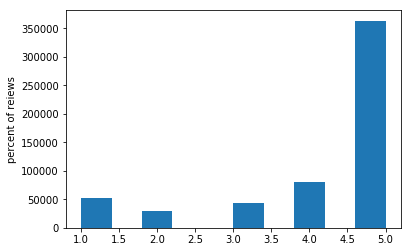

In [ ]:
import matplotlib.pyplot as plt
plt.hist(df["Score"])
plt.ylabel('percent of reiews')
plt.show()

# bi-grams and n-grams

In [ ]:
freq_positive=nltk.FreqDist(all_positive_words)
freq_negative=nltk.FreqDist(all_negative_words)
print("Most common positive words:",freq_positive.most_common(20))
print("moost common negative words",freq_negative.most_common(20))

Most common positive words: [(b'like', 115700), (b'tast', 108819), (b'love', 99783), (b'good', 98085), (b'great', 95369), (b'flavor', 91039), (b'use', 85646), (b'product', 80243), (b'one', 80102), (b'tri', 76138), (b'tea', 68114), (b'coffe', 67032), (b'make', 62517), (b'get', 60011), (b'food', 52700), (b'buy', 48934), (b'time', 46460), (b'would', 46440), (b'realli', 44912), (b'amazon', 44382)]
moost common negative words [(b'tast', 29364), (b'like', 27107), (b'product', 24209), (b'one', 17242), (b'flavor', 16149), (b'would', 15450), (b'tri', 15344), (b'good', 12895), (b'coffe', 12446), (b'buy', 12405), (b'use', 12290), (b'order', 11657), (b'get', 11434), (b'food', 9955), (b'tea', 9589), (b'box', 9083), (b'even', 9050), (b'amazon', 8528), (b'time', 8139), (b'bag', 7989)]


In [ ]:
#bigrams
count_vect=CountVectorizer(ngram_range=(1,2))
final_bigram_counts=count_vect.fit_transform(final["Text"].values)



In [ ]:
#final_bigram_counts.size()
final_bigram_counts.shape


(364171, 2910192)

# 

In [ ]:
final_bigram_counts.get_shape()

(364171, 2910192)

# tf-idf

In [ ]:
tf_idf_vect=TfidfVectorizer(ngram_range=(1,2))
final_tf_idf=tf_idf_vect.fit_transform(final["Text"].values)


In [ ]:
final_tf_idf.shape

In [ ]:
final_tf_idf

In [ ]:
features=tf_idf_vect.get_feature_names()
len(features)

In [ ]:
features[10000:10100]

In [ ]:
#some vector is printing
print(final_tf_idf[3000,:].toarray()[0])

In [ ]:
def top_tfidf_feats(row,features,top_n=25):
    topn_ids=np.argsort(row)[::-1][:top_n]
    top_feats=[(features[i],row[i],i)for i in topn_ids]
    df=pd.DataFrame(top_feats)
    df.columns=(['features','tfidf',"index"])
    return df
top_tfidf=top_tfidf_feats(final_tf_idf[10987,:].toarray()[0],features,25)

In [ ]:
top_tfidf

# word2vec

In [ ]:
#chekck with the google wrod2vec it's size is more then 1.9gb nd requires atleast 16gb of ram

In [ ]:
import sys
!{sys.executable} -m pip install gensim

In [ ]:
import gensim


In [ ]:
i=0
list_of_sent=[]
for sent in final["Text"].values:
    filterd_sentence=[]
    sent=cleanhtml(sent)
    for w in sent.split():
        for cleaned_words in cleanpunc(w).split():
            if(cleaned_words.isalpha()):
                filterd_sentence.append(cleaned_words.lower())
            else:
                continue
    list_of_sent.append(filterd_sentence)
    

In [ ]:
print(final["Text"].values[0])
print("8"*100)
print(list_of_sent[0])

In [ ]:
w2v_model=gensim.models.Word2Vec(list_of_sent,min_count=5,size=10,workers=2 )
#min_Count=5 means if a word occours less than 5 times then dont consider it
#size means no of dimensions to represent
#workers are  no of cores of cpu

In [ ]:
words=list(w2v_model.wv.vocab)
print(len(words))

In [ ]:
w2v_model.wv.most_similar("tasty")

In [ ]:
w2v_model.wv.most_similar("man")

In [ ]:
w2v_model.wv.most_similar("like")

# avgw2v

In [ ]:
sent_vectors=[]
for sent in list_of_sent:
    sent_vec=np.zeros(50)
    cnt_words=0
    for word in sent:
        try:
            vec=w2v_model.wv[word]
            sent_vec+=vec
            cnt_words+=1
        except:
            pass
    sent_vec/=cnt_words
    sent_vectors.append(sent_vec)
print(len(sent_vectors))
print(len(sent_vectors[0]))
    

# tfidf word2v

In [1]:
tfidf_feat=tf_idf_vect.get_feature_names()
tfidf_sent_vectors=[]
row=0
for sent in list_of_sent:
    sent_vec=np.zeros(50)
    weighted_sum=0
    for word in sent:
        try:
            vec=w2v_model.wv[word]
            tfidf=final_tf_idf[row,tfidf_feat.index(word)]
            sent_vec+=(vec*tf_idf)
            weighted_sum+=tf_idf
        except:
            pass
    sent_vec/=weighted_sum
    tfidf_sent_vectors.append(sent_vec)
    row+=1
    

NameError: name 'tf_idf_vect' is not defined